<h1 style="font-family: Didot; font-size: 50px; text-align: center;">🐕 Doge plot 🐕</h1>
<h3 style="font-family: Didot; font-size: 20px; text-align: center; font-style: italic;">~ by MarcinM</h3>

---

In [10]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from celluloid import Camera
from IPython.display import HTML
from matplotlib.gridspec import GridSpec
import matplotlib.image as image

sns.set_style("darkgrid")
plt.rcParams['animation.embed_limit'] = 2**128
plt.rcParams['figure.figsize'] = [13, 7]

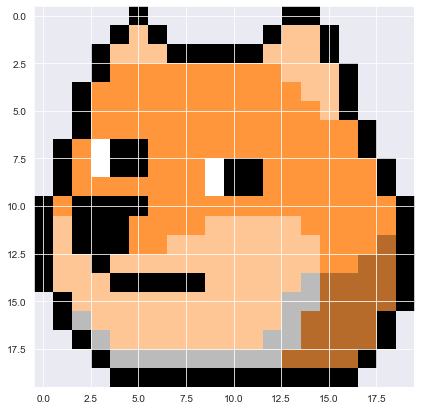

In [11]:
img=image.imread('doge.png')
plt.imshow(img)

In [12]:
X, Y, _ = img.shape

xs = np.tile(np.arange(X), Y)
ys = np.repeat(-np.arange(Y), X)
colors = [color for row in img for color in row]

NOISE_X = np.random.uniform(-1, 1, size=X*Y)
NOISE_Y = np.random.uniform(-1, 1, size=X*Y)

doge_df = pd.DataFrame({'x': xs, 
                        'noise_x': NOISE_X, 
                        'y': ys, 
                        'noise_y': NOISE_Y, 
                        'color': colors})

In [13]:
def wave(i, N, d=8, f=1):
    return -0.5/np.arctan(d)*np.arctan(d*np.cos(2 * np.pi * f * i/N)) + 0.5

In [14]:
x = doge_df['x']
y = doge_df['y']
noise_x = doge_df['noise_x']
noise_y = doge_df['noise_y']
color = doge_df['color']

In [15]:
%%capture

gs = GridSpec(4, 4)

fig = plt.figure(figsize=(10, 10))
ax_scatter = fig.add_subplot(gs[1:4, 0:3])
ax_scatter.set_ylim([-Y - 15, 15])
ax_scatter.set_xlim([-15, X + 15])

ax_hist_x = fig.add_subplot(gs[0,0:3])
ax_hist_x.axis('off')
ax_hist_y = fig.add_subplot(gs[1:4, 3])
ax_hist_y.axis('off')

In [16]:
force = 15
frames = 500


camera = Camera(fig)

for i in range(frames):
    
    ax_scatter.scatter(x + wave(i, frames) * force * noise_x,
                       y + wave(i, frames) * force * noise_y,
                       color = color, s=150)
    
    ax_hist_x.hist(x + wave(i, frames) * force * noise_x, color="#FF963B")
    ax_hist_y.hist(y + wave(i, frames) * force * noise_y, color="#FF963B", orientation="horizontal")
    
    if i < frames/10 or i > frames - frames/10:
        ax_scatter.annotate("> DIY - wizualizacja danych", (0, 5), fontsize=17)
        
    camera.snap()

In [17]:
# WARNING - time-consuming

animation = camera.animate(blit=True, interval=10)
HTML(animation.to_jshtml())

In [18]:
animation.save('doge1.mp4', writer='ffmpeg', dpi=100)